# Individual Assignment
## StudentName: Kizito Moses
## RegistrationNo: 2022/HD07/1971U



For this assignment, I would like to start by calling various python libraries that would be of use.

In [1]:
# Importing Libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pandas_profiling import ProfileReport
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.svm import LinearSVC
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.metrics import precision_score, recall_score, confusion_matrix, classification_report, accuracy_score, f1_score
from sklearn import metrics
from sklearn.metrics import roc_curve, auc, roc_auc_score
import warnings
warnings.filterwarnings('ignore')

/tmp/ipykernel_16861/1198151533.py:6: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  from pandas_profiling import ProfileReport


Here, am loading the fetal_health dataset and use the head function to have an understanding of my dataset. 
I am also using other python functions such as describe(), and info() so that i understand the nature of my dataset in terms of variables (quantitative or qualitative), and the available records. I am also interested to know the size of my dataset so that i can decide on the appropriate ratio to split. 


The scale of measurement for the variables in the dataset is not clear as a data dictionary was not provided. For example, the utrine contractions values, are expected to be whole number values NOT decimals values as it is in the dataset otherwise looking at the rest of variabls entries looks ok beside the few expected outliers that exists and the abnormal_short_term_variability variable which looks odd that all enteries are above zero. 


And here below, the code returns the first 70 rows in the upload dataset named dfet

In [2]:
dfet = pd.read_csv("fetal_health.csv")
dfet.head(70)
#print(dfet.size)

,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health
0,120.0,0.000,0.0,0.000,0.000,0.0,0.0,73.0,0.5,43.0,...,62.0,126.0,2.0,0.0,120.0,137.0,121.0,73.0,1.0,2.0
1,132.0,0.006,0.0,0.006,0.003,0.0,0.0,17.0,2.1,0.0,...,68.0,198.0,6.0,1.0,141.0,136.0,140.0,12.0,0.0,1.0
2,133.0,0.003,0.0,0.008,0.003,0.0,0.0,16.0,2.1,0.0,...,68.0,198.0,5.0,1.0,141.0,135.0,138.0,13.0,0.0,1.0
3,134.0,0.003,0.0,0.008,0.003,0.0,0.0,16.0,2.4,0.0,...,53.0,170.0,11.0,0.0,137.0,134.0,137.0,13.0,1.0,1.0
4,132.0,0.007,0.0,0.008,0.000,0.0,0.0,16.0,2.4,0.0,...,53.0,170.0,9.0,0.0,137.0,136.0,138.0,11.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65,150.0,0.000,0.0,0.004,0.000,0.0,0.0,40.0,0.8,37.0,...,143.0,161.0,1.0,0.0,153.0,153.0,154.0,0.0,0.0,1.0
66,138.0,0.001,0.0,0.004,0.000,0.0,0.0,44.0,1.0,20.0,...,81.0,180.0,9.0,2.0,162.0,156.0,159.0,8.0,1.0,1.0
67,140.0,0.007,0.0,0.004,0.000,0.0,0.0,34.0,1.2,0.0,...,119.0,179.0,2.0,0.0,156.0,153.0,155.0,5.0,0.0,1.0
68,140.0,0.007,0.0,0.004,0.000,0.0,0.0,34.0,1.2,0.0,...,119.0,179.0,2.0,0.0,156.0,153.0,155.0,5.0,0.0,1.0


The dataset seem to be collected during labour to monitor fetal health during labour. I am am trying to know the size of my dataset and it is clear that my dataset has a size of 2126 rows and 22 variables or features.

In [3]:
print(" The size of the fetal dataset:", dfet.size)
dfet.shape

 The size of the fetal dataset: 46772


(2126, 22)

Here below am trying to know the nature of 22 variables and it is noted that all the variables are quantitative of float nature as shown below however it is also worthy to note that there 3 categorical variables that are numerically coded and ths captured as numerical variables.

In [4]:
dfet.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2126 entries, 0 to 2125
Data columns (total 22 columns):
 #   Column                                                  Non-Null Count  Dtype  
---  ------                                                  --------------  -----  
 0   baseline value                                          2126 non-null   float64
 1   accelerations                                           2126 non-null   float64
 2   fetal_movement                                          2126 non-null   float64
 3   uterine_contractions                                    2126 non-null   float64
 4   light_decelerations                                     2126 non-null   float64
 5   severe_decelerations                                    2126 non-null   float64
 6   prolongued_decelerations                                2126 non-null   float64
 7   abnormal_short_term_variability                         2126 non-null   float64
 8   mean_value_of_short_term_variability  

In the code below, am extracting the descriptive statistics of the respective variables of the entire dfet dataset. The total variables are counted (2126), min, max, mean, standard deviation, and the quartiles such as first and third quartiles of the different variables of the dataset. From, I further drill down as follows below to understand the minimum varuables of 0 and max if they are within the variable range or not. It is transposed as shown below to have a clear view of the variables' descriptive statistics.

In [5]:
dfet.describe().T

,count,mean,std,min,25%,50%,75%,max
baseline value,2126.0,133.303857,9.840844,106.0,126.000,133.000,140.000,160.000
accelerations,2126.0,0.003178,0.003866,0.0,0.000,0.002,0.006,0.019
fetal_movement,2126.0,0.009481,0.046666,0.0,0.000,0.000,0.003,0.481
uterine_contractions,2126.0,0.004366,0.002946,0.0,0.002,0.004,0.007,0.015
light_decelerations,2126.0,0.001889,0.002960,0.0,0.000,0.000,0.003,0.015
severe_decelerations,2126.0,0.000003,0.000057,0.0,0.000,0.000,0.000,0.001
prolongued_decelerations,2126.0,0.000159,0.000590,0.0,0.000,0.000,0.000,0.005
abnormal_short_term_variability,2126.0,46.990122,17.192814,12.0,32.000,49.000,61.000,87.000
mean_value_of_short_term_variability,2126.0,1.332785,0.883241,0.2,0.700,1.200,1.700,7.000
percentage_of_time_with_abnormal_long_term_variability,2126.0,9.846660,18.396880,0.0,0.000,0.000,11.000,91.000


With 2126 records and 22 variables, i think it is appropraite to use a 20% : 80% ratio. 

At this point, i would like to get the Exploratory Data Analysis report of the fetal dataset to understand the individual varriables in terms of distribution, variable nature, outliers, missing values etc. 

And this EDA, i will the pandas_profiling library to generate this report to provide me with an overview of my dataset.

In [6]:
profile = ProfileReport(dfet, title='Pandas Profiling Report', html={'style': {'full_width': True}})
profile.to_file('output.html')


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [7]:
profile

The Pandas profiling indicates 11 duplicates in the dataset and therefore, we eliminate them using the code below to improve the quality of our built model.

In [8]:
dfet.drop_duplicates(inplace=True)
dfet.to_csv("dfet_cleaned.csv",index=False)

In [9]:
# Reading the cleaned dataset into my environment
dfetcnd = pd.read_csv('dfet_cleaned.csv')
dfetcnd.shape

(2113, 22)

# rechecking for duplicates presense again


In [10]:
duplicates = dfetcnd[dfetcnd.duplicated()]
print(duplicates.shape)

(0, 22)


The performance metrix will be used to measure the performance of the model to be developed in the subsquent codes below:

* Precision
* Recall
* Confusion Matrix
* F1 Score

To have a better understanding, let us evaluate the correlation matrix.

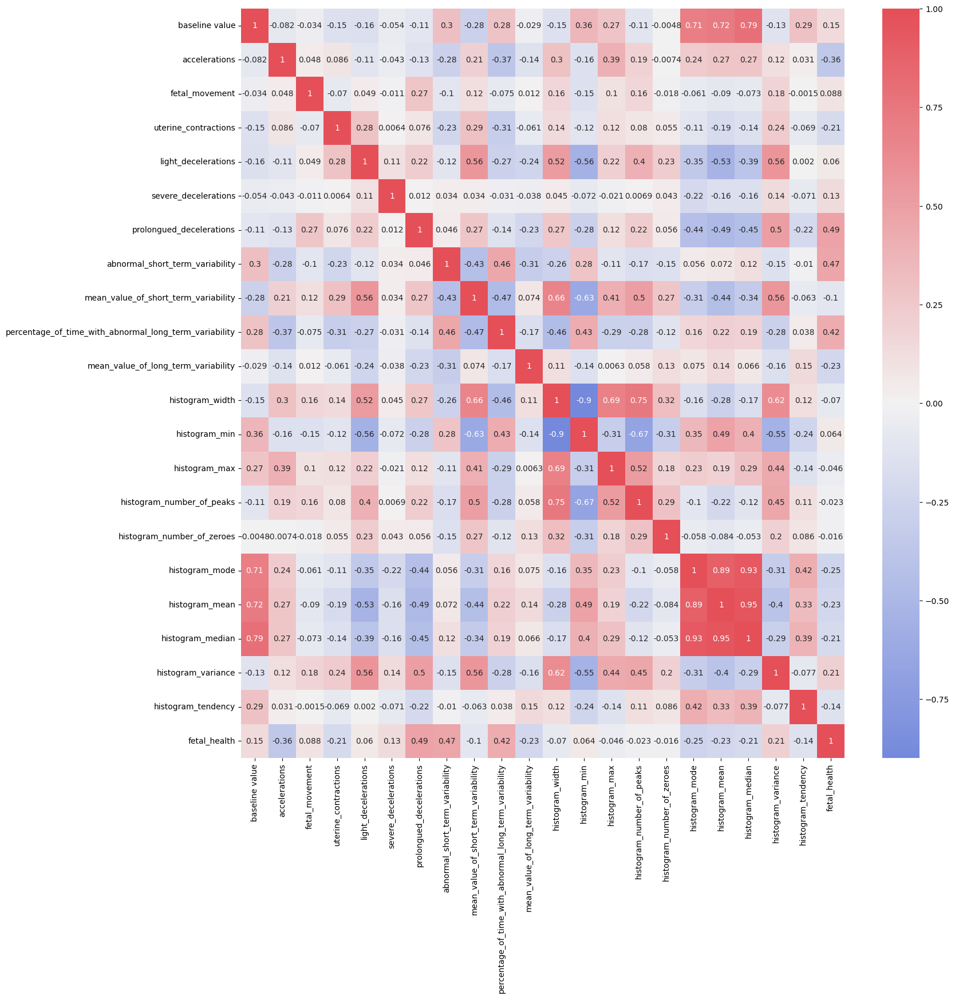

In [11]:
%matplotlib inline
#correlation matrix code

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# compute correlation matrix
corrmat = dfetcnd.corr()

# create heatmap plot of correlation matrix
plt.figure(figsize=(17,17))  
cmap = sns.diverging_palette(260, 10, s=70, l=55, n=9, as_cmap=True)
sns.heatmap(corrmat, annot=True, cmap=cmap, center=0)
plt.show()


Prolonged deceleration and absormal short term variability are moderately related with the fetal health well being and They indicate fetal distress. The acceleration have a negative correlation value with abnormal featal health.

The following variables have higher correlation with fetal_health
* prolongued_decelerations
* abnormal_short_term_variability
* percentage_of_time_with_abnormal_long_term_variability
* Acceleration
* fetal_movement

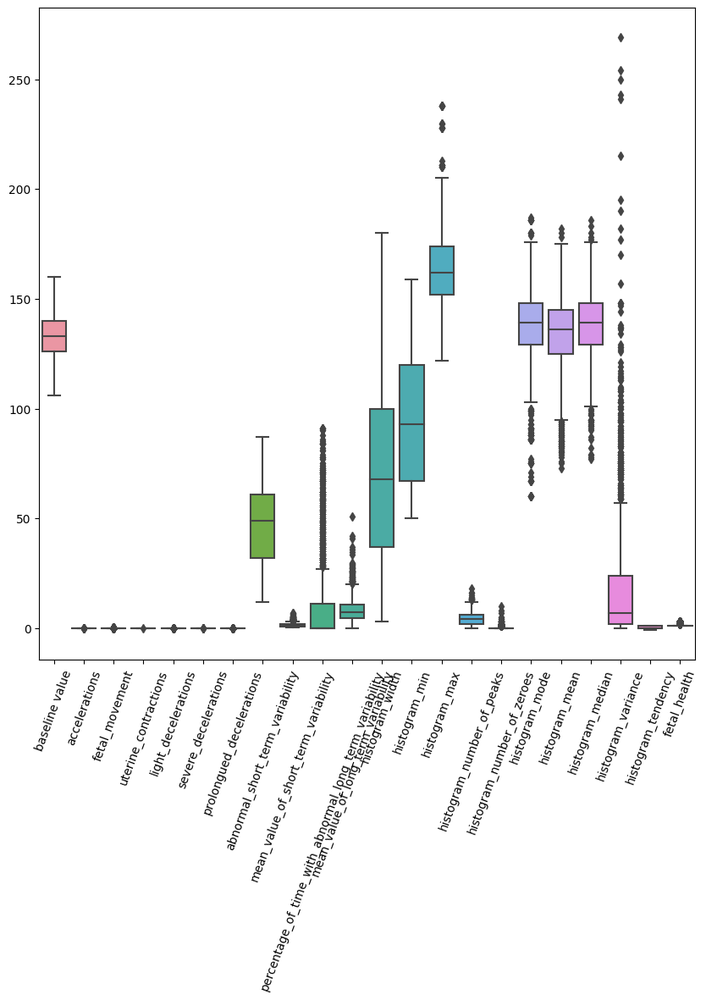

In [12]:
clrs =["#FF5733","#f7b2b0","#c98ea6","#8f7198","#50587f", "#003f5c","#C70039", "#900C3F"]
plt.figure(figsize=(10,10))
#sns.boxenplot(data = dfetcnd)

sns.boxplot(dfetcnd)
plt.xticks(rotation=70)
plt.show()

* The output above, indicates a need for variable to be scale up and standardised so that they are in the same range.
* In the model building, we will preprocess the features to do the same.

# **<span style="color:#FF5732;">Model Spot Checking n & Building</span>**
In this section we will:
* Set up features(X) and target(Y)
* Scale the features
* Split training and test sets in -1.2 : 0.8 ration 
* Model selection
* Hyperparameter tuning

In [13]:
#assigning values to features as X and target as y
# I am creating a new DF without the variable fetal_health
X = dfetcnd.drop(["fetal_health"],axis=1)
# The acode above creates a dataset without the feat_health
y = dfetcnd["fetal_health"]

# standard scaler for the variables / features
col_names = list(X.columns)
s_scaler = preprocessing.StandardScaler()
X_dfet= s_scaler.fit_transform(X)
Xdfet = pd.DataFrame(X_dfet, columns=col_names) 

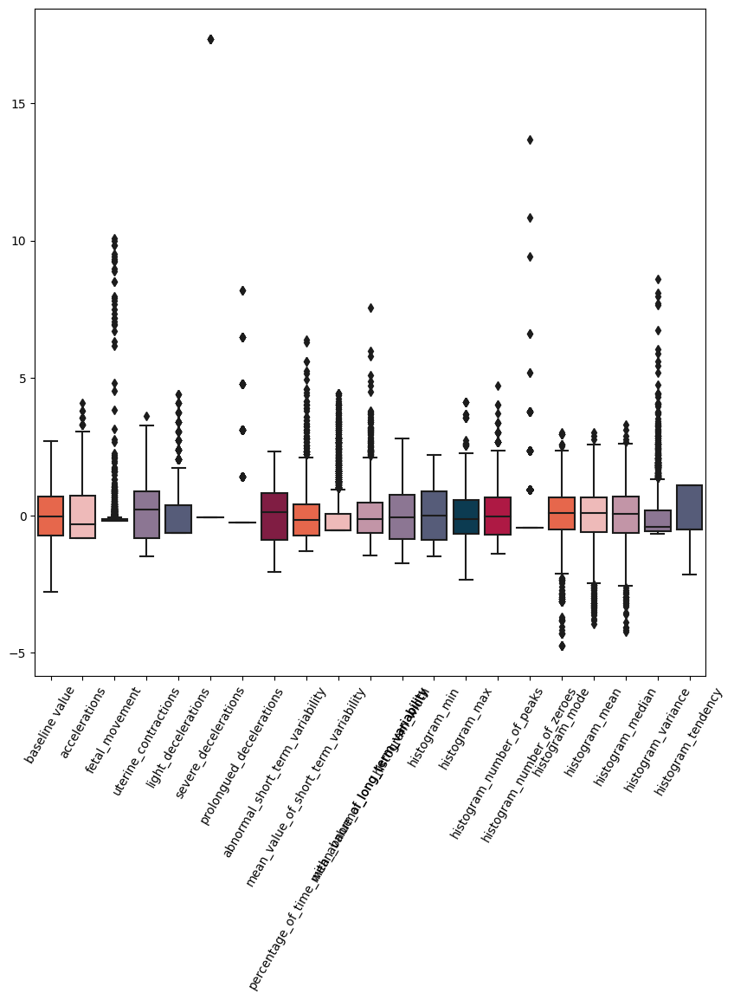

In [14]:
clrs =["#FF5733","#f7b2b0","#c98ea6","#8f7198","#50587f", "#003f5c","#C70039", "#900C3F"]
plt.figure(figsize=(10,10))
sns.boxplot(data=Xdfet, palette=clrs)
plt.xticks(rotation=60)

plt.show()

* Now that the Xdfet dataframe is standardised and within the same range. 
* Outliers are visible in certainy variables like histogram_number_of_zeros,mean value_of_long_term_varability etc, however they will be kept for a while.

* spliting the stardardised dataset in the 20% to 80% ratio.

In [15]:
X_train, X_test, y_train,y_test = train_test_split(Xdfet,y,test_size=0.2,random_state=40)

Since the fetal_health variable is a categorical variable, it implies that it is a classification problem and therefore, we use classification ML algorithms to build our model. Thats to say 6 ML algorithms below:
* KNeighbors Classifier
* Random Forest 
* Decision Tree 
* Support Vector Classifier (SVC)
* Linear Discriminate Analysis
* LogisticRegression

In [16]:
#A quick model selection process
#pipelines of models( it is short was to fit and pred)

from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.neural_network import MLPClassifier

pipeline_lr=Pipeline([('lr_classifier',LogisticRegression(random_state=42))])

pipeline_dt=Pipeline([ ('dt_classifier',DecisionTreeClassifier(random_state=42))])

pipeline_rf=Pipeline([('rf_classifier',RandomForestClassifier())])

pipeline_svc=Pipeline([('sv_classifier',SVC())])

pipeline_kn = Pipeline([('kn_classifier', KNeighborsClassifier(n_neighbors=5))])

pipeline_lda = Pipeline([('lda', LinearDiscriminantAnalysis())])
#pipeline_nn = Pipeline(['nn_classifier',Neural Networks()])
#nn = MLPClassifier(hidden_layer_sizes=(50,25), activation='relu', solver='adam', random_state=42)
#pipeline_nn = Pipeline([('scaler', StandardScaler()), ('nn_classifier', nn)])

# List of all the pipelines
pipelines = [pipeline_lr, pipeline_dt, pipeline_rf, pipeline_svc, pipeline_kn, pipeline_lda]

# Dictionary of pipelines and classifier types for ease of reference
pipe_dict = {0: 'LinearDiscriminantAnalysis', 
             1: 'Decision Tree', 
             2: 'RandomForest', 
             3: "SVC", 
             4: "KNeighborsClassifier", 
             5: "Logistic Regression", 
            }


# Fit the pipelines
for pipe in pipelines:
    pipe.fit(X_train, y_train)

#cross validation on accuracy 
cv_results_accuracy = []
for i, model in enumerate(pipelines):
    cv_score = cross_val_score(model, X_train,y_train, cv=10 )
    cv_results_accuracy.append(cv_score)
    print("%s: %f " % (pipe_dict[i], cv_score.mean()))

LinearDiscriminantAnalysis: 0.891716 
Decision Tree: 0.911243 
RandomForest: 0.939053 
SVC: 0.908876 
KNeighborsClassifier: 0.907692 
Logistic Regression: 0.872781 


* Since random forest provides a 94% score, it is the best amongest all the ML algorithms used. 
* Lets proceed with rf.

In [17]:
pred_rf_model = pipeline_rf.predict(X_test)
accuracy = accuracy_score(y_test, pred_rf_model)

print("The random forest score is: {:.3f}".format(accuracy))


The random forest score is: 0.929


In [18]:
confusion = confusion_matrix(y_test, pred_rf_model)
print('Confusion Matrix:\n',  confusion)


Confusion Matrix:
 [[331   6   0]
 [ 15  31   2]
 [  5   2  31]]


In the confusion matrix above, 330 represents the number of instances in fetal health that were truly of the first class and were predicted correctly as the first class.The element in the second row and third column (2) indicates the number of instances in fetal health (target column) that were truly of the second class but were predicted as the third class.

In [19]:
from sklearn.metrics import f1_score
# calculate the F1-score using the macro parameter
f1score = f1_score(y_test, pred_rf_model, average='macro')

print("The F1-Score is: {:.2f}".format(f1score))

The F1-Score is: 0.85


In [20]:
from sklearn.metrics import recall_score
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier


# calculate the recall for class 0 using the macro parameter

#for i in range(1,4):

recall = recall_score(y_test, pred_rf_model, labels=[i], average='macro')

print("The recall for the three respective classes is: {:.2f}".format(recall))


The recall for the three respective classes is: 0.00


I have applied the evalution metrics like recall (0.87), F1-Score (0.87) and confusion matrix scores, Therefore, we can conclude that the build random forest model shows an 87 pecent accurancy. 

In [21]:
import numpy as np
from scipy import stats

# calculate the Z-score for each data point in the DataFrame
z_scores = stats.zscore(dfetcnd)

# identify outliers as points with a Z-score greater than 3 or less than -3
outliers = np.abs(z_scores) > 3

# remove outliers from the DataFrame
dfetoutliers = dfetcnd[~outliers.any(axis=1)]


In [22]:
#assigning values to features as X and target as y
# I am creating a new DF without the variable fetal_health
X = dfetoutliers.drop(["fetal_health"],axis=1)
# The acode above creates a dataset without the feat_health
y = dfetoutliers["fetal_health"]

# standard scaler for the variables / features
col_names = list(X.columns)
s_scaler = preprocessing.StandardScaler()
X_dfetout= s_scaler.fit_transform(X)
Xdfetout = pd.DataFrame(X_dfetout, columns=col_names) 

Over 356 rows of outliers have been eliminated from the dataset and now we want to continue checking the built model to see if there is an improvement in the model.

In [23]:
X_trainout, X_testout, y_trainout,y_testout = train_test_split(dfetoutliers,y,test_size=0.2,random_state=40)

# Now am using the split dataset below

#A quick model selection process
#pipelines of models( it is short was to fit and pred)

from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.neural_network import MLPClassifier

pipeline_lr=Pipeline([('lr_classifier',LogisticRegression(random_state=42))])

pipeline_dt=Pipeline([ ('dt_classifier',DecisionTreeClassifier(random_state=42))])

pipeline_rf=Pipeline([('rf_classifier',RandomForestClassifier())])

pipeline_svc=Pipeline([('sv_classifier',SVC())])

pipeline_kn = Pipeline([('kn_classifier', KNeighborsClassifier(n_neighbors=5))])

pipeline_lda = Pipeline([('lda', LinearDiscriminantAnalysis())])
#pipeline_nn = Pipeline(['nn_classifier',Neural Networks()])
#nn = MLPClassifier(hidden_layer_sizes=(50,25), activation='relu', solver='adam', random_state=42)
#pipeline_nn = Pipeline([('scaler', StandardScaler()), ('nn_classifier', nn)])

# List of all the pipelines
pipelines = [pipeline_lr, pipeline_dt, pipeline_rf, pipeline_svc, pipeline_kn, pipeline_lda]

# Dictionary of pipelines and classifier types for ease of reference
pipe_dict = {0: 'LinearDiscriminantAnalysis', 
             1: 'Decision Tree', 
             2: 'RandomForest', 
             3: "SVC", 
             4: "KNeighborsClassifier", 
             5: "Logistic Regression", 
            }


# Fit the pipelines
for pipe in pipelines:
    pipe.fit(X_trainout, y_trainout)

#cross validation on accuracy 
cv_results_accuracy = []
for i, model in enumerate(pipelines):
    cv_score = cross_val_score(model, X_trainout,y_trainout, cv=10 )
    cv_results_accuracy.append(cv_score)
    print("%s: %f " % (pipe_dict[i], cv_score.mean()))



LinearDiscriminantAnalysis: 0.935932 
Decision Tree: 1.000000 
RandomForest: 0.996444 
SVC: 0.882523 
KNeighborsClassifier: 0.903865 
Logistic Regression: 0.900344 


With the 11 outliers removed from the dataset, beside the SVC algorthm which descresed from 90.1 percent to 88.2 percent, the rest of the ML algorithms have improved as indicated to 94 percent from 89 percent for Linear Discriminant Analysis algorithms, 100 percent from 91 percent for Decision Tree, to 99.7 percent from 94 percent for Random Forest, to 90.4 percent to 90.8 percent for KNeighborsClassifierbut and to 90 percent from 87.3 percent for the Logistic Regression algorthms, We still think it is better to uphold the random forest algorithm as it seem to be consistent at around 95 percent to 99 percent.. 